Requirment

In [ ]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 994.0/994.0 kB 52.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 116.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 85.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 55.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 93.6 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstal

Checking GPU availability

In [ ]:
!nvidia-smi

Mon Apr  7 13:13:24 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   50C    P8             10W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

#loading Data (copying to "content")

copying frrom zip file from google collab

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!cp /content/gdrive/MyDrive/data.zip /content

cp: cannot stat '/content/gdrive/MyDrive/data.zip': No such file or directory


In [ ]:
# Unzip images to a custom data folder
!unzip -q /content/drive/MyDrive/data.zip -d /content/custom_data

# Splitting dataset

the ratio is set to 0.9 for training

In [ ]:
from pathlib import Path
import random
import os
import shutil

# Set paths
data_path = "/content/custom_data/data"
train_percent = 0.9

# Validate input path
input_image_path = os.path.join(data_path, 'images')
input_label_path = os.path.join(data_path, 'labels')

if not os.path.isdir(data_path):
    raise ValueError(f'Directory not found: {data_path}')

if not (0.01 <= train_percent <= 0.99):
    raise ValueError(f'Invalid train split: {train_percent}. Must be between 0.01 and 0.99.')

# Output directories
output_base = "/content/data"
train_img_path = os.path.join(output_base, 'train/images')
train_lbl_path = os.path.join(output_base, 'train/labels')
val_img_path = os.path.join(output_base, 'validation/images')
val_lbl_path = os.path.join(output_base, 'validation/labels')

# Create output directories
for path in [train_img_path, train_lbl_path, val_img_path, val_lbl_path]:
    os.makedirs(path, exist_ok=True)

# Collect files
img_files = list(Path(input_image_path).rglob('*'))
img_files = [f for f in img_files if f.suffix.lower() in ['.jpg', '.jpeg', '.png']]
random.shuffle(img_files)

# Split data
split_index = int(len(img_files) * train_percent)
train_files = img_files[:split_index]
val_files = img_files[split_index:]

print(f"Total images: {len(img_files)}")
print(f"Training: {len(train_files)}, Validation: {len(val_files)}")

def copy_files(file_list, img_dest, lbl_dest):
    for img_path in file_list:
        base_name = img_path.stem
        txt_file = os.path.join(input_label_path, base_name + '.txt')

        shutil.copy(img_path, os.path.join(img_dest, img_path.name))

        if os.path.exists(txt_file):
            shutil.copy(txt_file, os.path.join(lbl_dest, base_name + '.txt'))

# Copy files
copy_files(train_files, train_img_path, train_lbl_path)
copy_files(val_files, val_img_path, val_lbl_path)

print("Dataset split complete.")


Total images: 204
Training: 183, Validation: 21
Dataset split complete.


# Training Config

In [ ]:
# Python function to automatically create data.yaml config file
# 1. Reads "classes.txt" file to get list of class names
# 2. Creates data dictionary with correct paths to folders, number of classes, and names of classes
# 3. Writes data in YAML format to data.yaml

import yaml
import os

def create_data_yaml(path_to_classes_txt, path_to_data_yaml):

  # Read class.txt to get class names
  if not os.path.exists(path_to_classes_txt):
    print(f'classes.txt file not found! Please create a classes.txt labelmap and move it to {path_to_classes_txt}')
    return
  with open(path_to_classes_txt, 'r') as f:
    classes = []
    for line in f.readlines():
      if len(line.strip()) == 0: continue
      classes.append(line.strip())
  number_of_classes = len(classes)

  # Create data dictionary
  data = {
      'path': '/content/data',
      'train': 'train/images',
      'val': 'validation/images',
      'nc': number_of_classes,
      'names': classes
  }

  # Write data to YAML file
  with open(path_to_data_yaml, 'w') as f:
    yaml.dump(data, f, sort_keys=False)
  print(f'Created config file at {path_to_data_yaml}')

  return

# Define path to classes.txt and run function
path_to_classes_txt = '/content/custom_data/data/classes.txt'
path_to_data_yaml = '/content/data.yaml'

create_data_yaml(path_to_classes_txt, path_to_data_yaml)

print('\nFile contents:\n')
!cat /content/data.yaml

Created config file at /content/data.yaml

File contents:

path: /content/data
train: train/images
val: validation/images
nc: 5
names:
- frixion
- htw
- muji
- round_stic
- starpie


# Training (parameters)

## 5.1 Training Parameters
Now that the data is organized and the config file is created, we're ready to start training! First, there are a few important parameters to decide on. Visit my article on [Training YOLO Models Locally](https://www.ejtech.io/learn/train-yolo-models) to learn more about these parameters and how to choose them.

**Model architecture & size (`model`):**

There are several YOLO11 models sizes available to train, including `yolo11n.pt`, `yolo11s.pt`, `yolo11m.pt`, `yolo11l.pt`, and `yolo11xl.pt`. Larger models run slower but have higher accuracy, while smaller models run faster but have lower accuracy. I made a brief YouTube video that compares performance of different YOLO models on a Raspberry Pi 5 and a laptop with a RTX 4050 GPU, [check it out here to get a sense of their speed accuracy](https://youtu.be/_WKS4E9SmkA). If you aren't sure which model size to use, `yolo11s.pt` is a good starting point.

You can also train YOLOv8 or YOLOv5 models by substituting `yolo11` for `yolov8` or `yolov5`.


**Number of epochs (`epochs`)**

In machine learning, one “epoch” is one single pass through the full training dataset. Setting the number of epochs dictates how long the model will train for. The best amount of epochs to use depends on the size of the dataset and the model architecture. If your dataset has less than 200 images, a good starting point is 60 epochs. If your dataset has more than 200 images, a good starting point is 40 epochs.


**Resolution (`imgsz`)**

Resolution has a large impact on the speed and accuracy of the model: a lower resolution model will have higher speed but less accuracy. YOLO models are typically trained and inferenced at a 640x640 resolution. However, if you want your model to run faster or know you will be working with low-resolution images, try using a lower resolution like 480x480.


# Start Training

In [ ]:
!yolo detect train data=/content/data.yaml model=yolo11s.pt epochs=60 imgsz=640

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
100% 18.4M/18.4M [00:00<00:00, 428MB/s]
Ultralytics 8.3.105 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11s.pt, data=/content/data.yaml, epochs=60, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou

In [ ]:
# from ultralytics import YOLO

# # Load the YOLOv8 Nano model
# model = YOLO('yolov8n.pt')

# # Train the model
# model.train(
#     data='/content/data.yaml',  # path to your dataset config
#     epochs=60,
#     imgsz=640
# )

Ultralytics 8.3.103 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/data.yaml, epochs=60, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True,

100%|██████████| 755k/755k [00:00<00:00, 20.4MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 93.4MB/s]


AMP: checks passed ✅


train: Scanning /content/data/train/labels... 183 images, 0 backgrounds, 6 corrupt: 100%|██████████| 183/183 [00:00<00:00, 2201.34it/s]

train: WARNING ⚠️ /content/data/train/images/20250405_202958052_iOS.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0878]
train: WARNING ⚠️ /content/data/train/images/20250405_203055103_iOS.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0068]
train: WARNING ⚠️ /content/data/train/images/20250405_203151262_iOS.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.2595]
train: WARNING ⚠️ /content/data/train/images/20250405_203435445_iOS.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0211]
train: WARNING ⚠️ /content/data/train/images/20250405_204013611_iOS.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.1001]
train: WARNING ⚠️ /content/data/train/images/20250405_204626227_iOS.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0208      1.0041]
train: New cache creat

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/data/validation/labels... 21 images, 0 backgrounds, 0 corrupt: 100%|██████████| 21/21 [00:00<00:00, 1606.25it/s]

val: New cache created: /content/data/validation/labels.cache


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 60 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/60      2.18G      3.199      4.074      2.643          4        640: 100%|██████████| 12/12 [00:12<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:04<00:00,  4.58s/it]

                   all         21        105      0.011      0.533      0.039     0.0139



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/60      2.31G      2.434      3.524      1.962         12        640: 100%|██████████| 12/12 [00:05<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all         21        105     0.0128      0.762      0.101     0.0333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/60      2.33G      2.237      3.162      1.741          4        640: 100%|██████████| 12/12 [00:08<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.93it/s]

                   all         21        105     0.0156      0.867      0.145     0.0523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/60      2.34G      2.205      3.025      1.739          7        640: 100%|██████████| 12/12 [00:06<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.36it/s]

                   all         21        105     0.0156      0.895       0.11     0.0391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/60      2.37G       2.07      2.961      1.687          9        640: 100%|██████████| 12/12 [00:08<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.06it/s]

                   all         21        105      0.142       0.19      0.119     0.0499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/60      2.39G      2.087      2.953       1.68          5        640: 100%|██████████| 12/12 [00:08<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.90it/s]

                   all         21        105      0.121      0.266      0.114     0.0504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/60      2.41G      2.042      2.877      1.654         19        640: 100%|██████████| 12/12 [00:06<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.37it/s]

                   all         21        105     0.0842      0.333     0.0923     0.0347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/60      2.42G      1.983       2.82      1.608          7        640: 100%|██████████| 12/12 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]

                   all         21        105      0.156      0.181      0.106     0.0415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/60      2.44G      1.932      2.763      1.587          9        640: 100%|██████████| 12/12 [00:06<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.96it/s]

                   all         21        105     0.0626      0.362     0.0762     0.0302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/60      2.46G       1.96      2.782       1.61         18        640: 100%|██████████| 12/12 [00:07<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.96it/s]

                   all         21        105      0.138      0.276      0.136     0.0642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/60      2.47G      1.873      2.773       1.55          3        640: 100%|██████████| 12/12 [00:08<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.96it/s]

                   all         21        105     0.0868      0.347      0.106     0.0458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/60      2.49G      1.954      2.811      1.583          6        640: 100%|██████████| 12/12 [00:06<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.20it/s]

                   all         21        105      0.119      0.316      0.133     0.0529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/60      2.51G      1.855      2.695      1.525         13        640: 100%|██████████| 12/12 [00:07<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.00it/s]

                   all         21        105      0.177      0.305      0.159     0.0711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/60      2.53G      1.893      2.741      1.557          7        640: 100%|██████████| 12/12 [00:07<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.50it/s]

                   all         21        105      0.132      0.324      0.133     0.0517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/60      2.54G      1.881      2.715      1.567          6        640: 100%|██████████| 12/12 [00:06<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.46it/s]

                   all         21        105      0.133      0.343      0.122     0.0509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/60      2.56G      1.835      2.682      1.529          8        640: 100%|██████████| 12/12 [00:07<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.26it/s]

                   all         21        105      0.164      0.324      0.148     0.0561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/60      2.58G      1.877      2.669       1.53          4        640: 100%|██████████| 12/12 [00:07<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]

                   all         21        105       0.17      0.377      0.172     0.0765



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/60      2.59G      1.834      2.601      1.503         13        640: 100%|██████████| 12/12 [00:07<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.87it/s]

                   all         21        105      0.179      0.353      0.173     0.0691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/60      2.61G       1.89      2.604      1.519          5        640: 100%|██████████| 12/12 [00:08<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.30it/s]

                   all         21        105      0.196      0.369      0.176      0.075



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/60      2.63G      1.771      2.523      1.438          6        640: 100%|██████████| 12/12 [00:07<00:00,  1.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.85it/s]

                   all         21        105      0.169      0.276      0.172     0.0706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/60      2.65G      1.737      2.494      1.439         19        640: 100%|██████████| 12/12 [00:09<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.14it/s]

                   all         21        105      0.206      0.267      0.203     0.0925



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/60      2.66G      1.738      2.469       1.43         17        640: 100%|██████████| 12/12 [00:08<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.94it/s]

                   all         21        105      0.245      0.355      0.228     0.0919



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/60      2.68G      1.772      2.439      1.449         16        640: 100%|██████████| 12/12 [00:07<00:00,  1.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.89it/s]

                   all         21        105      0.214      0.313      0.218     0.0854



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/60       2.7G      1.763      2.453      1.449          7        640: 100%|██████████| 12/12 [00:07<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.59it/s]

                   all         21        105      0.271      0.245      0.193     0.0841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/60      2.71G      1.712      2.462      1.438          6        640: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.48it/s]

                   all         21        105      0.265      0.267      0.203     0.0871



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/60      2.73G      1.709      2.366      1.434         13        640: 100%|██████████| 12/12 [00:07<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.02it/s]

                   all         21        105      0.322      0.327      0.281      0.119



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/60      2.75G      1.707      2.386      1.434         10        640: 100%|██████████| 12/12 [00:07<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.68it/s]

                   all         21        105      0.346      0.259       0.26     0.0957



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/60      2.77G      1.717      2.361      1.435         16        640: 100%|██████████| 12/12 [00:08<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.19it/s]

                   all         21        105      0.258      0.397      0.273      0.119



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/60      2.78G      1.757      2.371      1.447         10        640: 100%|██████████| 12/12 [00:06<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.59it/s]

                   all         21        105      0.281      0.352      0.299      0.124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/60       2.8G      1.751      2.316      1.454         11        640: 100%|██████████| 12/12 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.03it/s]

                   all         21        105      0.296      0.371      0.312      0.138



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/60      2.81G      1.729      2.307      1.423          5        640: 100%|██████████| 12/12 [00:06<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.19it/s]

                   all         21        105       0.44      0.248      0.332      0.143



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/60      2.83G      1.682      2.199        1.4          5        640: 100%|██████████| 12/12 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.04it/s]

                   all         21        105      0.367      0.448      0.358      0.172



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/60      2.85G      1.677      2.192      1.395         11        640: 100%|██████████| 12/12 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all         21        105      0.406      0.467      0.371      0.173



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/60      2.87G       1.68      2.193      1.409         16        640: 100%|██████████| 12/12 [00:06<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.42it/s]

                   all         21        105      0.443      0.324      0.336      0.153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/60      2.88G      1.622      2.218      1.387          9        640: 100%|██████████| 12/12 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all         21        105       0.44       0.33      0.349      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/60       2.9G      1.623      2.138      1.383          8        640: 100%|██████████| 12/12 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.35it/s]

                   all         21        105      0.412        0.4      0.408      0.177



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/60      2.92G      1.609      2.059      1.369         14        640: 100%|██████████| 12/12 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.48it/s]

                   all         21        105      0.332      0.419       0.36      0.147



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/60      2.94G       1.63      2.062      1.353         17        640: 100%|██████████| 12/12 [00:08<00:00,  1.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all         21        105      0.494      0.344      0.397      0.164



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/60      2.95G      1.602      2.008       1.35          6        640: 100%|██████████| 12/12 [00:08<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.12it/s]

                   all         21        105        0.4       0.39      0.399      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/60      2.97G      1.602      2.092      1.372         10        640: 100%|██████████| 12/12 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.65it/s]

                   all         21        105      0.346      0.362      0.364      0.155



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/60      2.99G      1.606      2.026       1.35         15        640: 100%|██████████| 12/12 [00:09<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.82it/s]

                   all         21        105      0.384      0.423      0.397      0.173



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/60         3G      1.608      2.016      1.362         16        640: 100%|██████████| 12/12 [00:07<00:00,  1.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all         21        105      0.459      0.466       0.47      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/60      3.02G      1.601      2.005      1.338         18        640: 100%|██████████| 12/12 [00:06<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]

                   all         21        105      0.445      0.481      0.456      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/60      3.04G      1.582      2.022      1.349          3        640: 100%|██████████| 12/12 [00:07<00:00,  1.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.71it/s]

                   all         21        105      0.491      0.419      0.431      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/60      3.05G      1.647      2.206      1.375          3        640: 100%|██████████| 12/12 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.07it/s]

                   all         21        105      0.413      0.482      0.417      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/60      3.07G       1.58      1.948       1.35          8        640: 100%|██████████| 12/12 [00:08<00:00,  1.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.77it/s]

                   all         21        105      0.455      0.455      0.448      0.207



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/60      3.09G      1.503      1.954      1.304          3        640: 100%|██████████| 12/12 [00:09<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.62it/s]

                   all         21        105      0.548      0.512      0.532      0.235



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/60      3.11G      1.517      1.944      1.326          5        640: 100%|██████████| 12/12 [00:07<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.45it/s]

                   all         21        105       0.44       0.49      0.473      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/60      3.12G      1.549       1.89      1.319         17        640: 100%|██████████| 12/12 [00:08<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.92it/s]

                   all         21        105      0.529      0.494      0.521      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/60      3.14G      1.489      1.896      1.301          5        640: 100%|██████████| 12/12 [00:07<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.17it/s]

                   all         21        105      0.522       0.43      0.495      0.205


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      51/60      3.16G      1.541      1.857      1.339          5        640: 100%|██████████| 12/12 [00:17<00:00,  1.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.18it/s]

                   all         21        105      0.508      0.482      0.476      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      52/60      3.17G      1.575      1.882      1.307          5        640: 100%|██████████| 12/12 [00:10<00:00,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.79it/s]

                   all         21        105      0.466      0.485      0.468       0.21



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      53/60      3.19G        1.5      1.801      1.278          5        640: 100%|██████████| 12/12 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.09it/s]

                   all         21        105      0.449      0.521      0.485      0.211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      54/60      3.21G      1.483      1.675      1.275          5        640: 100%|██████████| 12/12 [00:08<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.46it/s]

                   all         21        105      0.496      0.546       0.49      0.205



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      55/60      3.22G      1.461      1.711      1.312          5        640: 100%|██████████| 12/12 [00:08<00:00,  1.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]

                   all         21        105      0.463       0.55      0.492      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      56/60      3.24G      1.422      1.649      1.264          5        640: 100%|██████████| 12/12 [00:06<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.22it/s]

                   all         21        105      0.472      0.555      0.489      0.221



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      57/60      3.26G      1.396      1.656      1.225          5        640: 100%|██████████| 12/12 [00:08<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.17it/s]

                   all         21        105      0.474      0.571      0.492       0.22



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      58/60      3.28G      1.414      1.583      1.236          5        640: 100%|██████████| 12/12 [00:09<00:00,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.62it/s]

                   all         21        105      0.429      0.505      0.457      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      59/60      3.29G      1.416      1.646      1.216          5        640: 100%|██████████| 12/12 [00:07<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all         21        105      0.472      0.502      0.484      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      60/60      3.31G      1.374      1.617      1.276          5        640: 100%|██████████| 12/12 [00:07<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.76it/s]

                   all         21        105      0.446      0.526      0.496      0.224



60 epochs completed in 0.159 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.3MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.103 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.35it/s]


                   all         21        105      0.546      0.509      0.532      0.234
               frixion         21         21      0.411      0.476      0.465      0.224
                   htw         21         21      0.517      0.667      0.581       0.28
                  muji         21         21       0.77       0.32      0.527      0.253
            round_stic         21         21      0.595       0.56      0.574      0.203
               starpie         21         21      0.439      0.521      0.513      0.209
Speed: 0.2ms preprocess, 3.1ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/train2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7efb992f4710>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

# Test the model

In [ ]:
!yolo detect predict model=runs/detect/train/weights/best.pt source=data/validation/images save=True

Ultralytics 8.3.105 🚀 Python-3.11.11 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s summary (fused): 100 layers, 9,414,735 parameters, 0 gradients, 21.3 GFLOPs

image 1/21 /content/data/validation/images/20250405_201838167_iOS.jpg: 480x640 1 htw, 1 starpie, 50.4ms
image 2/21 /content/data/validation/images/20250405_201908071_iOS.jpg: 480x640 1 frixion, 2 htws, 1 muji, 1 round_stic, 2 starpies, 12.5ms
image 3/21 /content/data/validation/images/20250405_202138065_iOS.jpg: 480x640 2 frixions, 1 htw, 1 muji, 2 round_stics, 1 starpie, 12.9ms
image 4/21 /content/data/validation/images/20250405_202255815_iOS.jpg: 640x480 1 frixion, 1 htw, 1 muji, 1 round_stic, 2 starpies, 50.6ms
image 5/21 /content/data/validation/images/20250405_202813430_iOS.jpg: 640x480 1 frixion, 1 muji, 1 round_stic, 2 starpies, 12.4ms
image 6/21 /content/data/validation/images/20250405_202932358_iOS.jpg: 480x640 1 frixion, 2 htws, 1 muji, 1 round_stic, 2 starpies, 13.2ms
image 7/21 /content/data/validation/images

In [ ]:
# # Load the trained model
# model = YOLO('runs/detect/train/weights/best.pt')

# # Run prediction on validation images
# model.predict(source='data/validation/images', save=True)


image 1/21 /content/data/validation/images/20250405_202116005_iOS.jpg: 480x640 1 frixion, 1 htw, 1 starpie, 38.4ms
image 2/21 /content/data/validation/images/20250405_202407558_iOS.jpg: 480x640 1 frixion, 2 htws, 1 muji, 1 round_stic, 1 starpie, 7.8ms
image 3/21 /content/data/validation/images/20250405_202441812_iOS.jpg: 640x480 1 frixion, 1 muji, 2 starpies, 41.8ms
image 4/21 /content/data/validation/images/20250405_202532072_iOS.jpg: 480x640 1 frixion, 1 htw, 7.7ms
image 5/21 /content/data/validation/images/20250405_203201412_iOS.jpg: 480x640 2 frixions, 1 round_stic, 7.1ms
image 6/21 /content/data/validation/images/20250405_203325013_iOS.jpg: 480x640 1 htw, 2 round_stics, 2 starpies, 10.6ms
image 7/21 /content/data/validation/images/20250405_203340553_iOS.jpg: 480x640 1 frixion, 2 htws, 1 round_stic, 2 starpies, 9.5ms
image 8/21 /content/data/validation/images/20250405_203553527_iOS.jpg: 640x480 1 round_stic, 10.5ms
image 9/21 /content/data/validation/images/20250405_203643233_iOS.

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'frixion', 1: 'htw', 2: 'muji', 3: 'round_stic', 4: 'starpie'}
 obb: None
 orig_img: array([[[ 0,  4,  5],
         [ 3,  7,  8],
         [ 5,  9, 10],
         ...,
         [22, 24, 25],
         [19, 21, 22],
         [16, 18, 19]],
 
        [[ 0,  4,  5],
         [ 2,  6,  7],
         [ 3,  7,  8],
         ...,
         [22, 24, 25],
         [21, 23, 24],
         [19, 21, 22]],
 
        [[ 0,  4,  5],
         [ 1,  5,  6],
         [ 2,  6,  7],
         ...,
         [21, 23, 24],
         [21, 23, 24],
         [20, 22, 23]],
 
        ...,
 
        [[16, 32, 39],
         [16, 32, 39],
         [15, 31, 38],
         ...,
         [22, 38, 51],
         [20, 36, 49],
         [21, 37, 50]],
 
        [[18, 34, 41],
         [17, 33, 40],
         [14, 30, 37],
         ...,
         [13, 29, 42],
         [13, 29, 42],


In [ ]:
# !yolo detect predict model=runs/detect/train/weights/best.pt source=data/validation/images save=True

# display the prediction reuslt

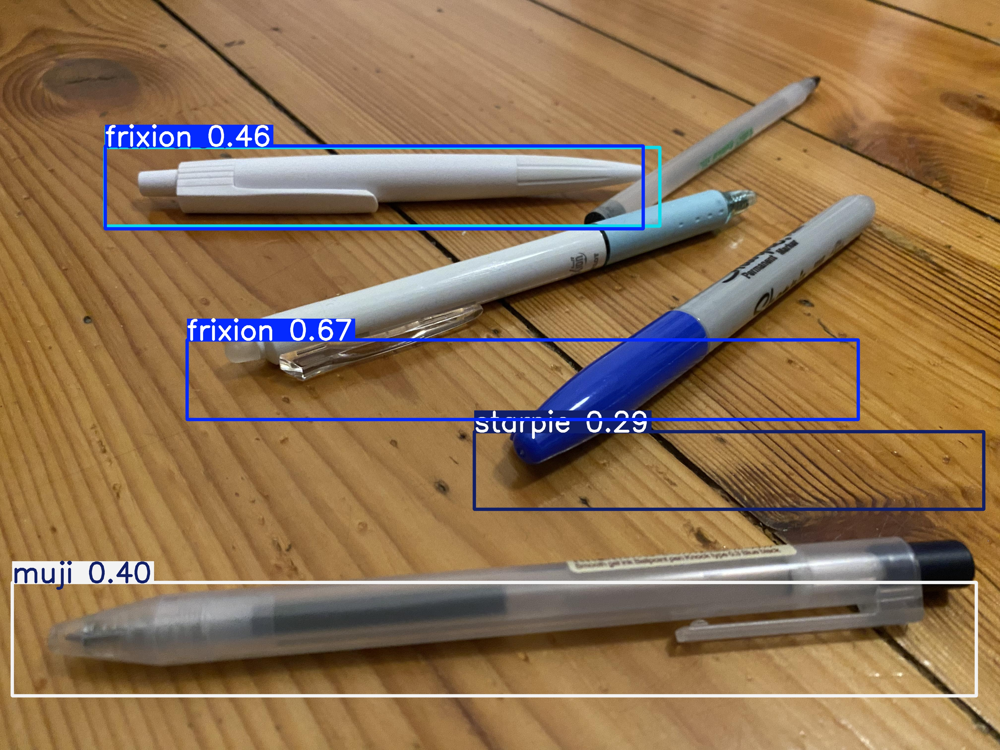

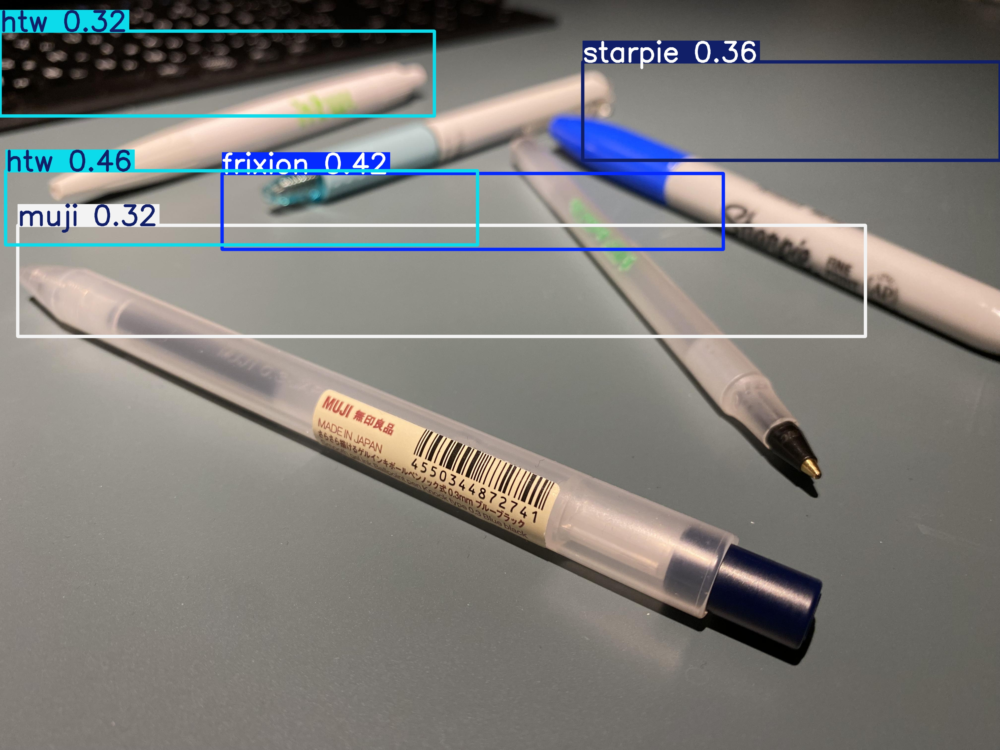

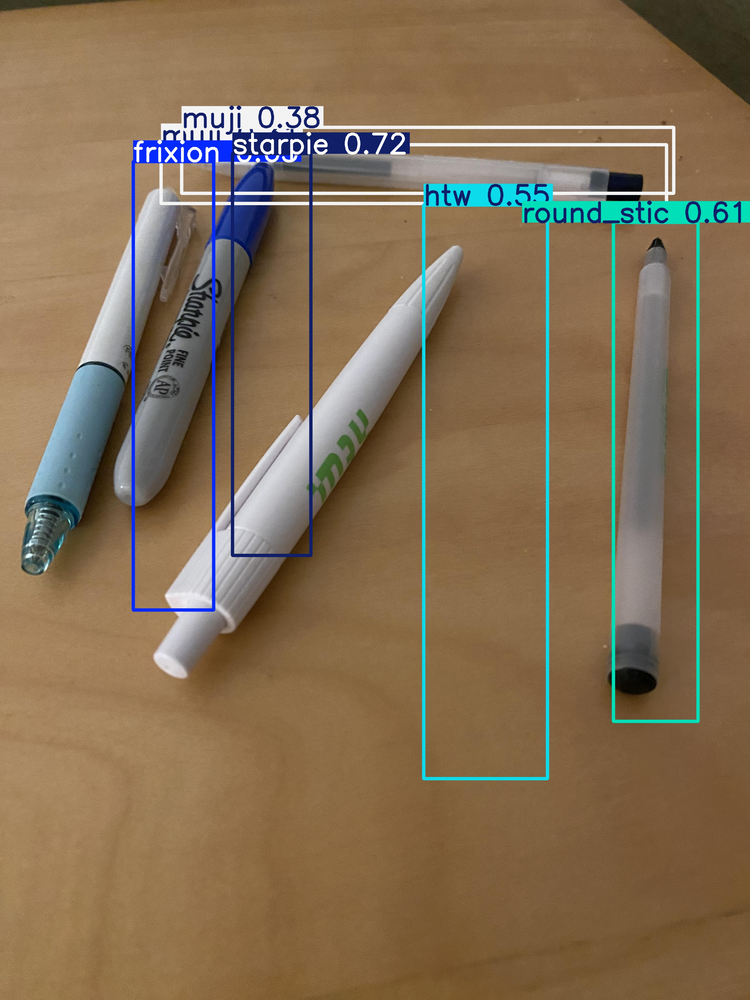

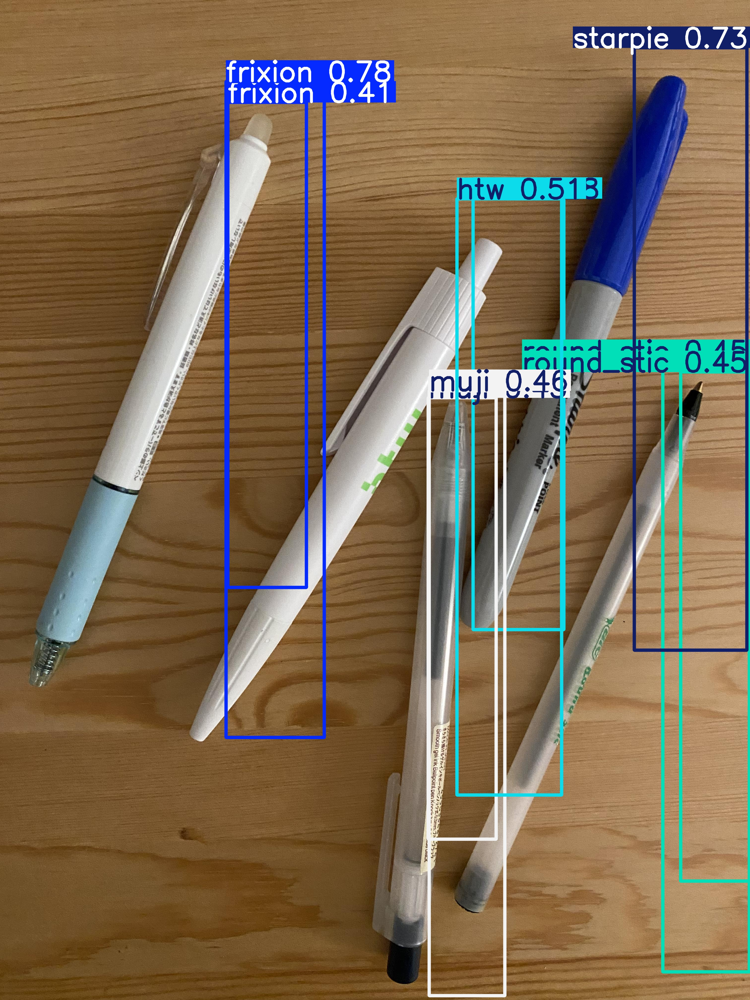

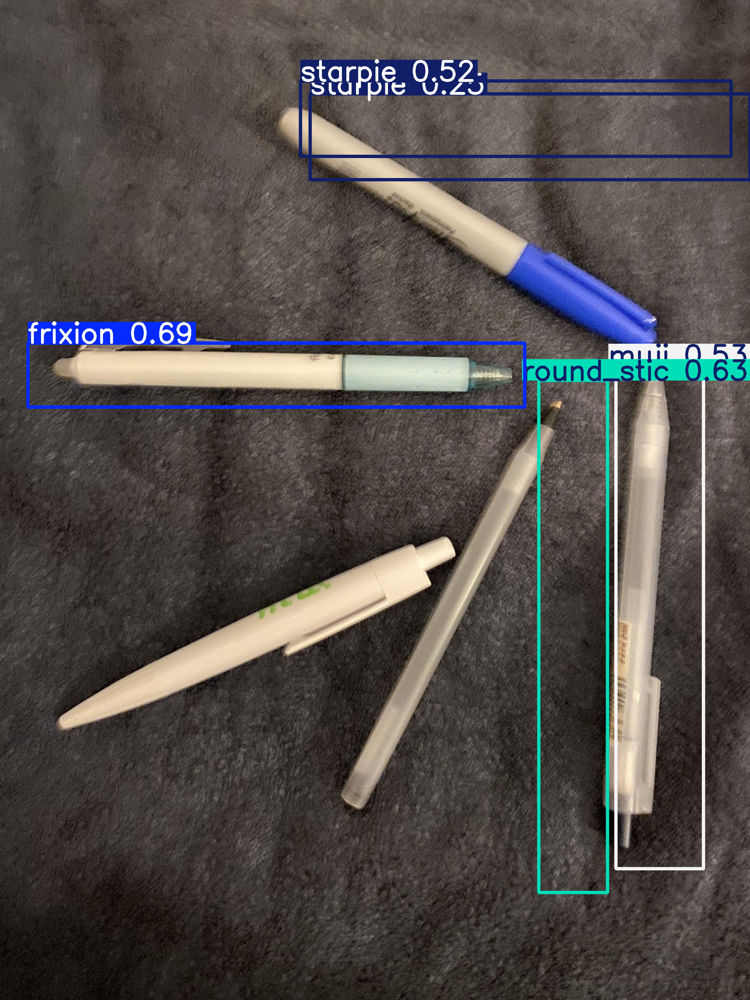

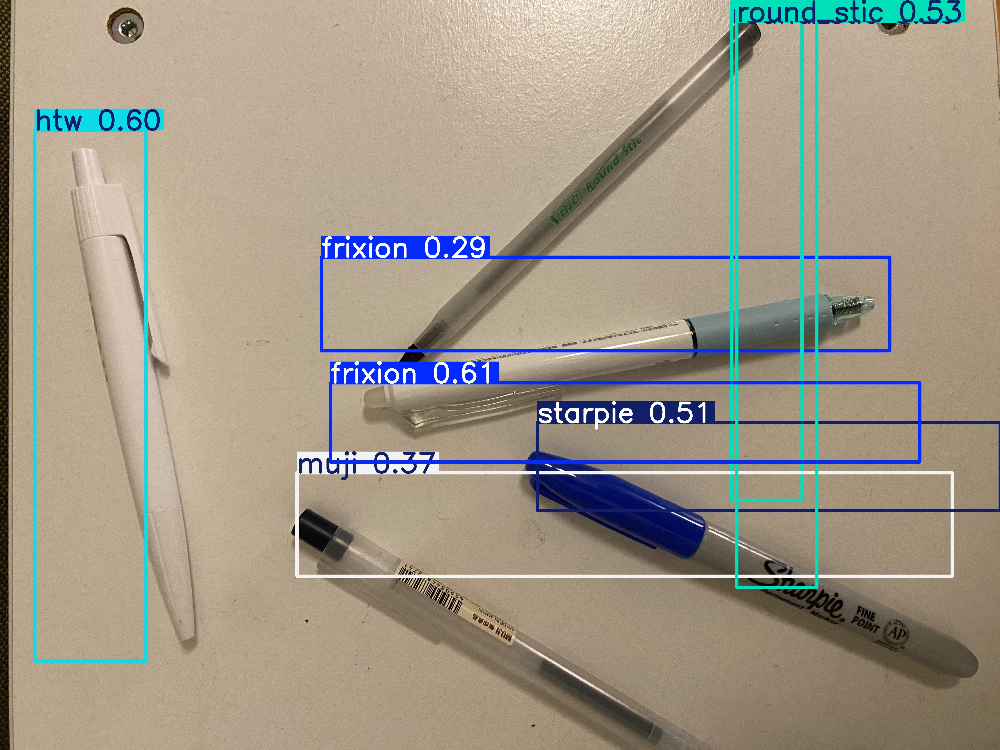

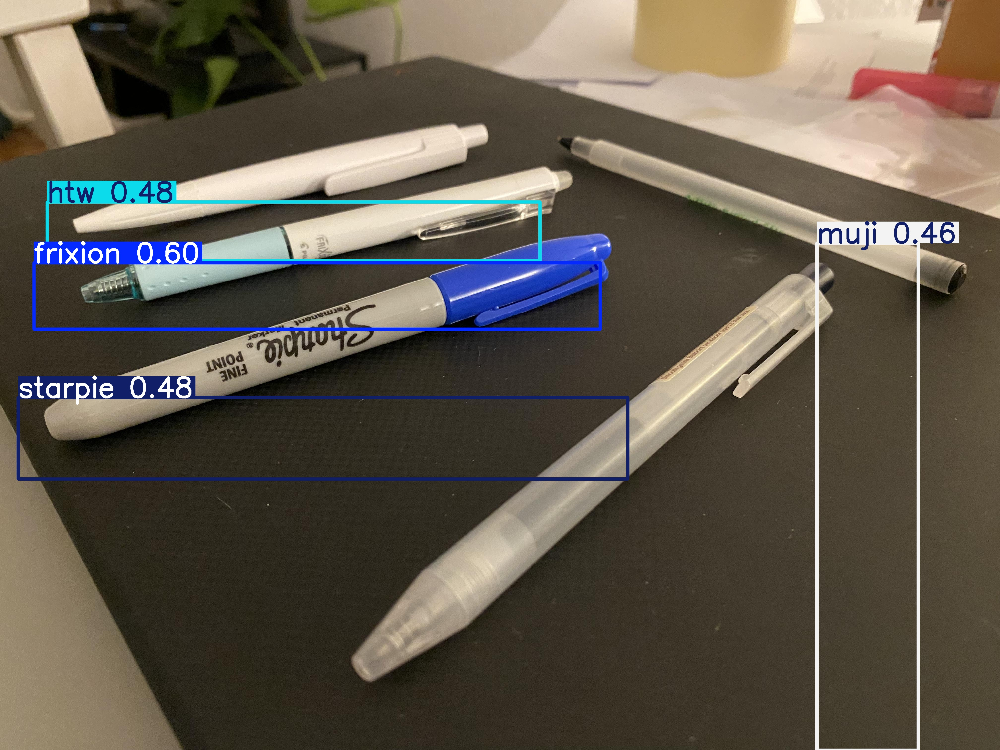

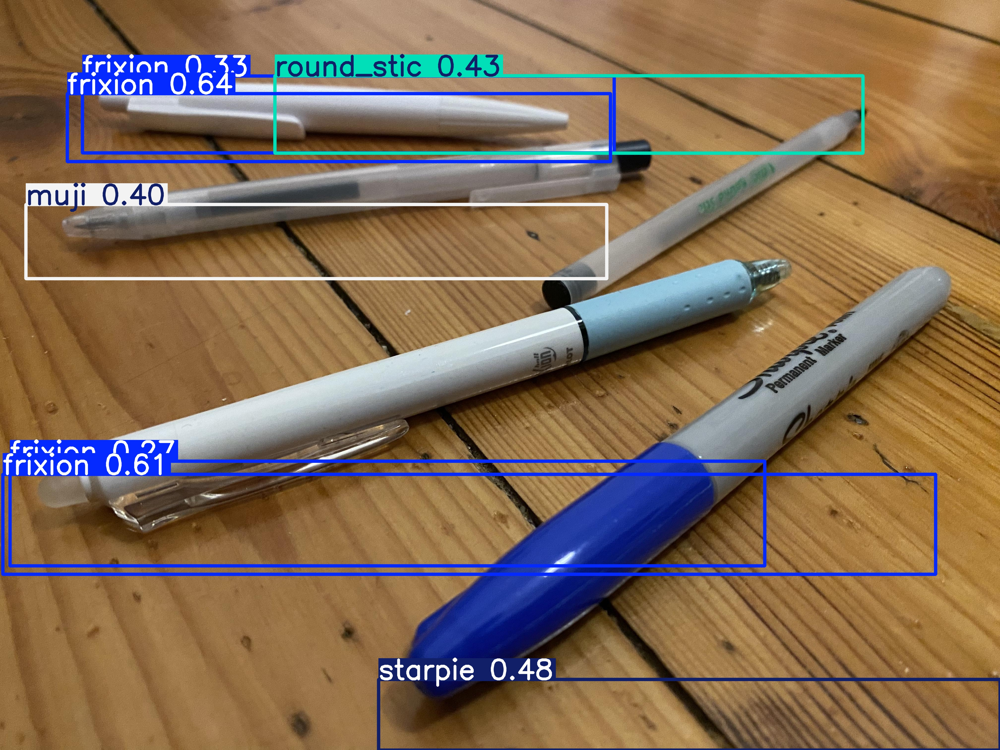

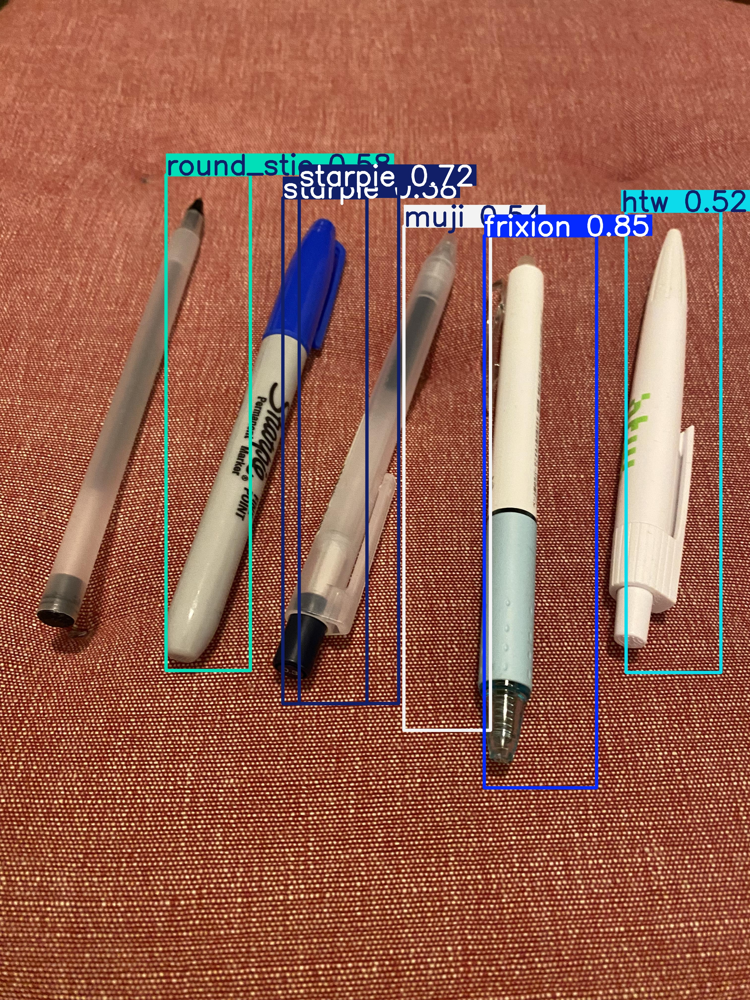

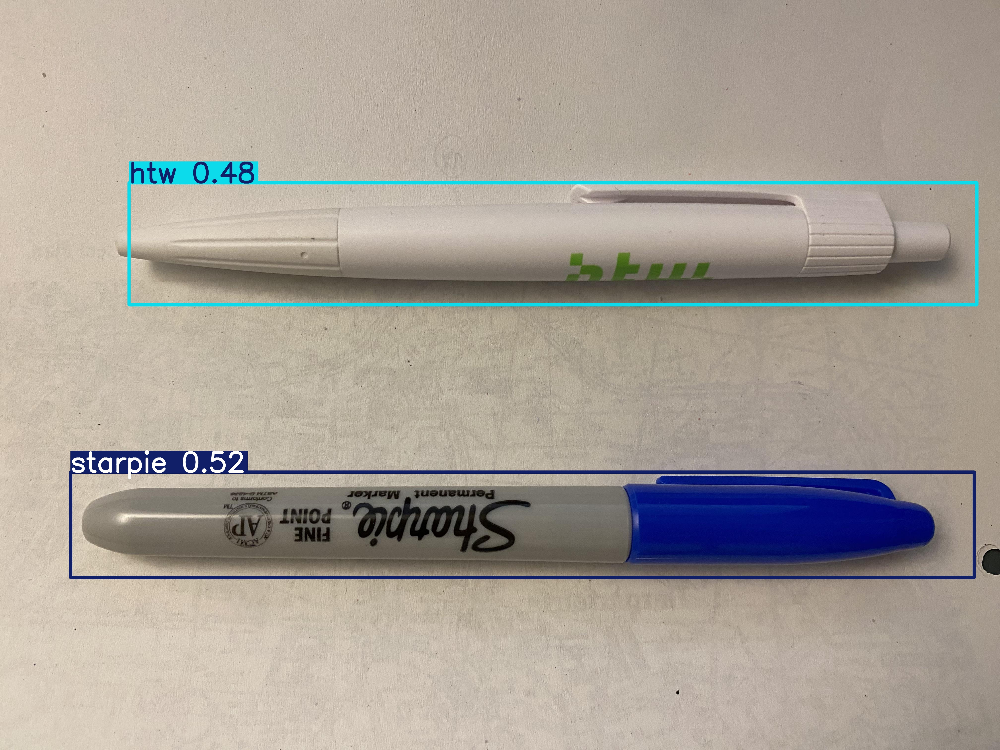

In [ ]:
import glob
from IPython.display import Image, display
for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg')[:10]:
  display(Image(filename=image_path, height=400))
  print('\n')


# Download the model

In [ ]:
# Create "my_model" folder to store model weights and train results
!mkdir /content/my_model
!cp /content/runs/detect/train/weights/best.pt /content/my_model/my_model.pt
!cp -r /content/runs/detect/train /content/my_model

# Zip into "my_model.zip"
%cd my_model
!zip /content/my_model.zip my_model.pt
!zip -r /content/my_model.zip train
%cd /content

/content/my_model
  adding: my_model.pt (deflated 8%)
  adding: train/ (stored 0%)
  adding: train/train_batch602.jpg (deflated 8%)
  adding: train/PR_curve.png (deflated 15%)
  adding: train/weights/ (stored 0%)
  adding: train/weights/best.pt (deflated 8%)
  adding: train/weights/last.pt (deflated 8%)
  adding: train/args.yaml (deflated 53%)
  adding: train/train_batch600.jpg (deflated 11%)
  adding: train/val_batch0_pred.jpg (deflated 10%)
  adding: train/confusion_matrix_normalized.png (deflated 25%)
  adding: train/events.out.tfevents.1744139669.cff1bb9ab3b8.3073.0 (deflated 91%)
  adding: train/labels.jpg (deflated 27%)
  adding: train/confusion_matrix.png (deflated 30%)
  adding: train/train_batch2.jpg (deflated 3%)
  adding: train/train_batch1.jpg (deflated 3%)
  adding: train/P_curve.png (deflated 8%)
  adding: train/labels_correlogram.jpg (deflated 41%)
  adding: train/train_batch601.jpg (deflated 10%)
  adding: train/results.png (deflated 7%)
  adding: train/R_curve.png (def

# Deployment

0. (install Anaconda if not yet)
1. Activate the python environment from CLI
2. Install all required packages
3. Activate the trailed model

In [ ]:
#1 Activate the python environment from CLI
conda activate yolo-env1

In [ ]:
#2 Uncomment the following line if you haven't installed ultralytics yet 
# pip install ultralytics

In [ ]:
# 3 Activate the trained model
python yolo_detect.py --model my_model.pt --source usb1